# Construct Warehouse Environment

In [1]:
import sys
sys.path.append('../')
from panav.environment.env import WareHouse
from panav.hybrid import HybridGraph
from panav.environment.utils import box_2d_center

from panav.viz import draw_env,draw_hybrid

%load_ext autoreload
%autoreload 2

# Warehouse environment

Constructing environment


/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/shapely/measurement.py:74: RuntimeWarning: invalid value encountered in distance
  return lib.distance(a, b, **kwargs)
/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/shapely/predicates.py:798: RuntimeWarning: invalid value encountered in intersects
  return lib.intersects(a, b, **kwargs)


Plotting environment


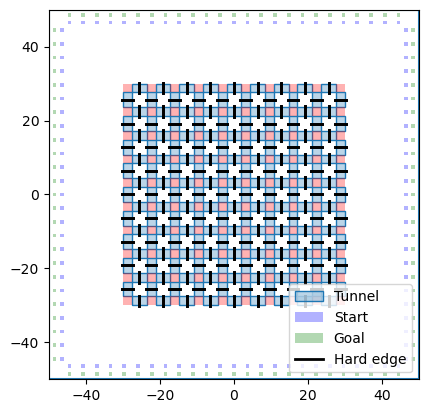

In [2]:
import numpy as np
# import networkx as nx
from panav.hybrid import WareHouseHG

bloating_r = 0.5
vmax = 1.0

N = 100
n_col = 10
n_row = 10
limits = [(-50,50),(-50,50)] 
shelf_region_x_limit=[-30,30]
shelf_region_y_limit=[-30,30]
corner_padding_x = bloating_r * 10
corner_padding_y = bloating_r * 10

obs_x_margin = 8 * bloating_r
obs_y_margin = 8 * bloating_r
# N = 20
# n_col = 4
# n_row = 4
# limits = [(-20,20),(-20,20)] 
# shelf_region_x_limit=[-7,7]
# shelf_region_y_limit=[-7,7]
# corner_padding_x = bloating_r * 10
# corner_padding_y = bloating_r * 10


env = WareHouse(limits = limits, N_agent = N, 
                shelf_region_x_limit=shelf_region_x_limit,shelf_region_y_limit=shelf_region_y_limit,
                obs_x_margin= obs_x_margin,
                obs_y_margin= obs_y_margin,
                n_col = n_col, n_row = n_row,
                corner_padding_x=corner_padding_x,corner_padding_y=corner_padding_y)



print('Constructing environment')
HG = WareHouseHG(env,bloating_r)
print('Plotting environment')
draw_hybrid(HG,display_node=False,display_soft=False)

In [12]:
from panav.PIBT import PIBT_plan
from panav.TrafficAwarePlanning import TAHP

for e in HG.edges:
    if HG.edges[e]['type'] == 'hard':
        HG.edges[e]['occupants'] = set()
        w,v = e
        HG.nodes[v]['occupant'] = HG.nodes[w]['occupant'] = None
      
plans = PIBT_plan(HG,vmax,bloating_r,TIMEOUT=100,debug = False,simple_plan=False)
# plans = TAHP(HG,vmax,bloating_r, TIMEOUT=100)

################# Time step 0 ################
################# Time step 1 ################
################# Time step 2 ################
################# Time step 3 ################
################# Time step 4 ################
################# Time step 5 ################
################# Time step 6 ################
################# Time step 7 ################
################# Time step 8 ################
################# Time step 9 ################
################# Time step 10 ################
################# Time step 11 ################
################# Time step 12 ################
################# Time step 13 ################
################# Time step 14 ################
################# Time step 15 ################
################# Time step 16 ################
################# Time step 17 ################
################# Time step 18 ################
################# Time step 19 ################
################# Time step 20 ################
##

/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/cvxpy/problems/problem.py:1391: UserWarning: 
    The problem is either infeasible or unbounded, but the solver
    cannot tell which. Disable any solver-specific presolve methods
    and re-solve to determine the precise problem status.

    For GUROBI and CPLEX you can automatically perform this re-solve
    with the keyword argument prob.solve(reoptimize=True, ...).
    
  warnings.warn(INF_OR_UNB_MESSAGE)


################# Time step 147 ################
################# Time step 148 ################
################# Time step 149 ################
################# Time step 150 ################
################# Time step 151 ################
################# Time step 152 ################
################# Time step 153 ################


/Users/tianpengzhang/opt/miniconda3/envs/PA-NAV/lib/python3.11/site-packages/cvxpy/problems/problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


################# Time step 154 ################
################# Time step 155 ################
################# Time step 156 ################
################# Time step 157 ################
################# Time step 158 ################
Planning using MILP
[-23.81122  -5.11264] [-25.6    1.76]
Potential deadlock 64
Deadlock resolved at theta= 0.7853981633974483
################# Time step 159 ################
Planning using MILP
[-23.64528  -5.08119] [-25.6    1.76]
################# Time step 160 ################
Planning using MILP
[-23.67207  -5.02621] [-25.6    1.76]
################# Time step 161 ################
Planning using MILP
[-23.84324  -4.97573] [-25.6    1.76]
################# Time step 162 ################
Planning using MILP
[-23.94594  -4.94544] [-25.6    1.76]
################# Time step 163 ################
################# Time step 164 ################
################# Time step 165 ################
Potential deadlock 80
Deadlock resolved at theta= 0.7

In [4]:
from matplotlib import pyplot as plt
from panav.viz import animation
from IPython.display import HTML, display
from matplotlib import rcParams

exec_tau = 1.0

rcParams['animation.embed_limit'] = 2**128
dt = exec_tau * 0.25
agents = range(len(plans))
pos_to_ani = [np.array(plans[a][1]) for a in agents]
anim = animation(env, pos_to_ani, bloating_r, dt = dt)
display(HTML(anim.to_jshtml()))
plt.close() 